# 1) California housing price prediction

This dataset is a little close to home (😉). Today, we'll import the California housing dataset from scikit-learn.

I want you to explore the data, split the data into train and test sets, construct and fit several models using the train set, and evaluate the performance of your model on both the train and test sets. You are free to use any regression model in scikit-learn, and I hope you will explore many different models and compare their performance.

In [ ]:
import sklearn.datasets

housing_dataset = sklearn.datasets.fetch_california_housing()

Start working to understand the dataset and see what you are provided. The `housing_dataset` contains the following attributes: `.data`, `.DESCR`, `.feature_names`, and `.target` (remember targets is the same as labels or y-values). Print each of these out to see what's in them and then explore shapes of the data (X) and targets (y). Feel free to print out or examine anything else you like (means, maximums, minimums, standard deviations, etc. of each feature or target).

In [ ]:
import pandas as pd
housing_dataset

{'DESCR': '.. _california_housing_dataset:\n\nCalifornia Housing dataset\n--------------------------\n\n**Data Set Characteristics:**\n\n    :Number of Instances: 20640\n\n    :Number of Attributes: 8 numeric, predictive attributes and the target\n\n    :Attribute Information:\n        - MedInc        median income in block\n        - HouseAge      median house age in block\n        - AveRooms      average number of rooms\n        - AveBedrms     average number of bedrooms\n        - Population    block population\n        - AveOccup      average house occupancy\n        - Latitude      house block latitude\n        - Longitude     house block longitude\n\n    :Missing Attribute Values: None\n\nThis dataset was obtained from the StatLib repository.\nhttp://lib.stat.cmu.edu/datasets/\n\nThe target variable is the median house value for California districts.\n\nThis dataset was derived from the 1990 U.S. census, using one row per census\nblock group. A block group is the smallest geograp

In [ ]:
df = pd.DataFrame(housing_dataset['data'], columns=housing_dataset['feature_names'])
df['target'] = housing_dataset['target']
df.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,target
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


In [ ]:
df.describe()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,target
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,3.870671,28.639486,5.429000,1.096675,1425.476744,3.070655,35.631861,-119.569704,2.068558
std,1.899822,12.585558,2.474173,0.473911,1132.462122,10.386050,2.135952,2.003532,1.153956
min,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.350000,0.149990
25%,2.563400,18.000000,4.440716,1.006079,787.000000,2.429741,33.930000,-121.800000,1.196000
50%,3.534800,29.000000,5.229129,1.048780,1166.000000,2.818116,34.260000,-118.490000,1.797000
75%,4.743250,37.000000,6.052381,1.099526,1725.000000,3.282261,37.710000,-118.010000,2.647250
max,15.000100,52.000000,141.909091,34.066667,35682.000000,1243.333333,41.950000,-114.310000,5.000010


Generate a geographic scatterplot of the entire dataset by plotting the *longitude on the x-axis* and the *latitude on the y-axis*. Set your aspect ratio to `equal` to get a roughly-equivalently-scaled plot and use `figsize=(13,10)` to enlarge the plot. Use a size parameter to scale the individual points by their associated population values (divide the population value by ~100 or so, so that the points aren't too large). Use a color parameter to color the individual points by their associated median house price/value (for any list/array, you can do this by just passing in `c=list`). Display a colorbar. Feel free to customize or reverse the colormap. Use an alpha parameter equal to 0.15 to help you see through the dataset more easily. Use the `.feature_names` attribute to set the x- and y-labels without explicitly typing the feature name (i.e. don't explicitly type the label name like `plt.xlabel("Longitude")`)). Add or modify anything else as you like.

Text(0, 0.5, 'Latitude')

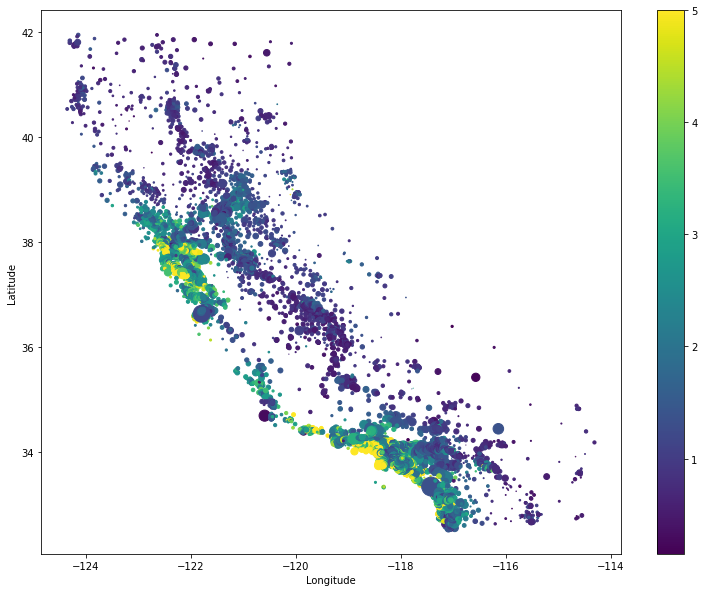

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
fig = plt.figure(figsize=(13,10))
ax = fig.gca()
ax.set_aspect('equal')

plt.scatter(df['Longitude'], df['Latitude'], s=(df['Population']/100), c=df['target'])
plt.colorbar()
plt.xlabel(housing_dataset.feature_names[-1])
plt.ylabel(housing_dataset.feature_names[-2])

Create several of your own plots exploring features of the California housing dataset. You might create more geographic-type plots, you might create histograms exploring the frequency of one particular feature, or you might scatterplot the features of the dataset in 2- or 3-dimensions. *Make at least 2 additional plots, but feel free to make as many as you like until you feel like you have a good grasp on the dataset.*

In [ ]:
# Hard to see visualisation
import folium
cali_map = folium.Map(location = [36.7783, -119.4179], zoom_start = 7)
houses = folium.map.FeatureGroup()

for lat, lng, in zip(df['Latitude'], df['Longitude']):
    houses.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=0.5, 
            color='red',
            fill=True,
            fill_opacity=0.6
        )
    )

cali_map.add_child(houses)

The following visualisation clusters houses which are close to each other to provide an easier visualisation. You can see the individual houses once you zoom in on the map.

In [ ]:
# Easier to see visualisation
# You can see the individual houses when you zoom in 
from folium import plugins

california_map = folium.Map(location = [36.7783, -119.4179], zoom_start = 7)
houses_ = plugins.MarkerCluster().add_to(california_map)
for lat, lng in zip(df['Latitude'], df['Longitude']):
    folium.Marker(
        location=[lat, lng],
        icon=None,
    ).add_to(houses_)

california_map

<Figure size 432x288 with 0 Axes>

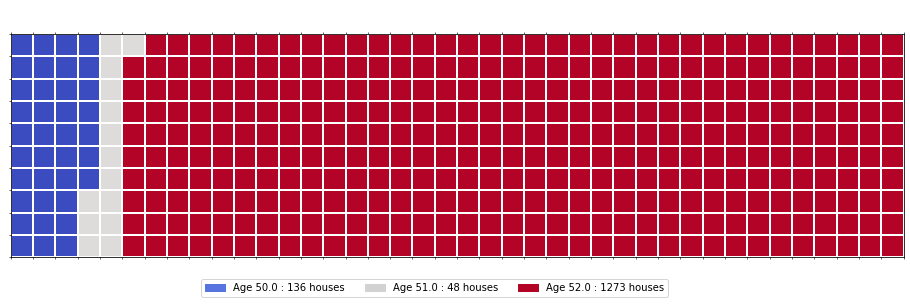

In [ ]:
#Creating a waffle chart to show the number of some of the oldest houses in California
max = df['HouseAge'].max()
val3 = df[df['HouseAge'] == max].shape[0]
val2 = df[df['HouseAge'] == (max-1)].shape[0]
val1 = df[df['HouseAge'] == (max-2)].shape[0]

val_list = [val1, val2, val3]
num_list = [max-2, max-1, max]

total_values = val1 + val2 + val3
category_proportions = [(float(value) / total_values) for value in val_list]

width = 40 
height = 10 
total_num_tiles = width * height 

tiles_per_category = [round(proportion * total_num_tiles) for proportion in category_proportions]
tiles_per_category[1] += 1

waffle_chart = np.zeros((height, width))
category_index = 0
tile_index = 0
for col in range(width):
    for row in range(height):
        tile_index += 1
        if tile_index > sum(tiles_per_category[0:category_index]):
            category_index += 1       

        waffle_chart[row, col] = category_index

fig = plt.figure()
colormap = plt.cm.coolwarm
plt.matshow(waffle_chart, cmap=colormap)
ax = plt.gca()
ax.set_xticks(np.arange(-.5, (width), 1), minor=True)
ax.set_yticks(np.arange(-.5, (height), 1), minor=True)
ax.grid(which='minor', color='w', linestyle='-', linewidth=2)

plt.xticks([])
plt.yticks([])
plt.title('Number of some of the oldest houses in California', c='w')

values_cumsum = np.cumsum(val_list)
total_values = values_cumsum[len(values_cumsum) - 1]

legend_handles = []
for i, category in enumerate(num_list):
    label_str = 'Age ' + str(category) + ' : ' + str(val_list[i]) + ' houses'
    color_val = colormap(float(values_cumsum[i])/total_values)
    if i == 1:
      color_val = [0.82421875,0.82421875,0.82421875, 1.0]
    legend_handles.append(mpatches.Patch(color=color_val, label=label_str))

plt.legend(handles=legend_handles,
           loc='lower center', 
           ncol=len(num_list),
           bbox_to_anchor=(0., -0.2, 0.95, .1)
          )

(array([ 719., 1104., 2235., 2681., 2510., 2354., 3555., 1900., 1616.,
        1966.]),
 array([ 1. ,  6.1, 11.2, 16.3, 21.4, 26.5, 31.6, 36.7, 41.8, 46.9, 52. ]),
 <a list of 10 Patch objects>)

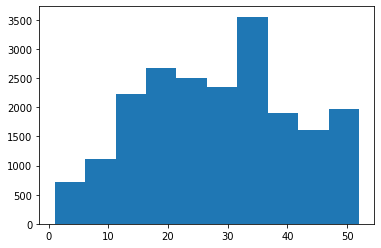

In [ ]:
plt.hist(x=df['HouseAge'], bins=10)

(array([ 6994., 10117.,  2720.,   538.,   179.,    92.]),
 array([ 0.4999,  2.9166,  5.3333,  7.75  , 10.1667, 12.5834, 15.0001]),
 <a list of 6 Patch objects>)

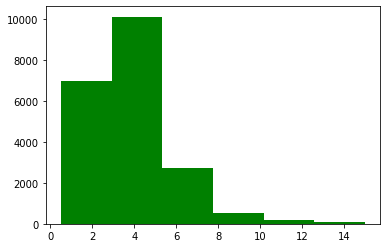

In [ ]:
plt.hist(x=df['MedInc'], bins=6, color='g')

We're going to look at cluster structure briefly. We'll load the `sklearn.preprocessing.StandardScaler` for scaling the features and targets. We join the X matrix and the y vector and then make a `scaler = StandardScaler()` that transforms the data using the `fit_transform` method. This dataset scaling will help the clustering algorithm identify better clusters by scaling the features more evenly. 

Now, you should import the `sklearn.cluster.KMeans` model. Using the keyword arguments, look for somewhere around 4, 5, or 6 clusters in the data (I prefer 5) and also use keyword parameters `max_iter=10000` and `n_init=100` to make sure you get good clusters. Perform clustering on `scaled_data`.

In [ ]:
from sklearn.preprocessing import StandardScaler

scaled_data = StandardScaler().fit_transform(np.append(housing_dataset.data, housing_dataset.target.reshape(-1, 1), axis=1))

from sklearn.cluster import KMeans
km = KMeans(n_clusters = 5, max_iter=10000, n_init=100).fit(scaled_data)

Now, reusing the geographical plot you made earlier, plot again the longitude and latitude (from the non-scaled/original dataset), but this time leave all the markers the same size (maybe `s=10`). Set the color parameter explicitly as the `.labels_` attribute from your trained `KMeans` model. Update your alpha parameter to `alpha=0.9` and choose a colormap that helps you see the data more clearly. You might look at the geography of California on Google (or Google Maps) to see if some of these clusters make sense to you! Add or modify anything else as you like.

Text(0, 0.5, 'Latitude')

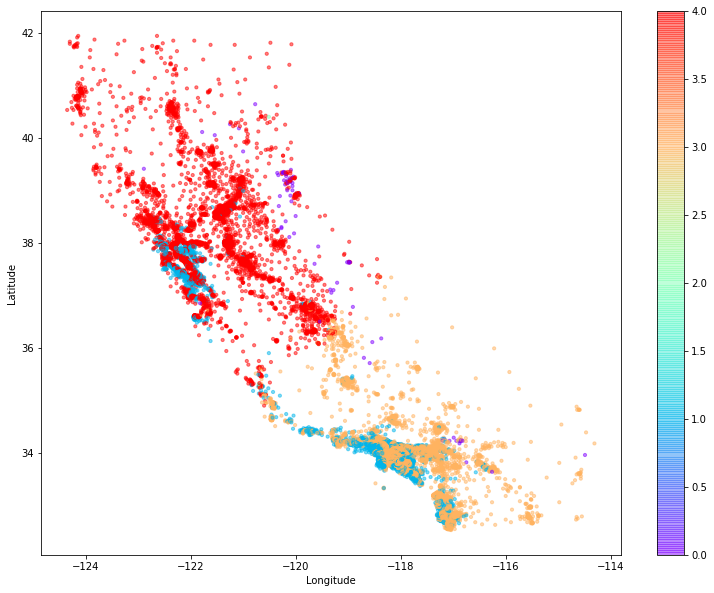

In [ ]:
fig = plt.figure(figsize=(13,10))
ax = fig.gca()
ax.set_aspect('equal')

plt.scatter(df['Longitude'], df['Latitude'], s=10, c=km.labels_, alpha = 0.5, cmap = 'rainbow')
plt.colorbar()
plt.xlabel(housing_dataset.feature_names[-1])
plt.ylabel(housing_dataset.feature_names[-2])

Now, let's explore regression models. 

First, generate an 80/20 train-test split using scikit-learn's built-in [train-test splitter](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html?highlight=train#sklearn.model_selection.train_test_split).

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df.iloc[:,0:8], df.iloc[:,8])

**The rest of this problem set is open-ended. Remember you can always work together with other students on any problem set -- reach out to others if you get stuck or share your knowledge with others if this comes easier to you!**

Look through the [Scikit-learn linear models API page](https://scikit-learn.org/stable/modules/classes.html#module-sklearn.linear_model) to find **at least** two regression models you want to use (if you want some defaults rather than picking your own, you can use the `LinearRegression`, `Lasso`, and `Ridge` regressor models). Read the documentation and look through examples on how to use them. The nomenclature for the parameters may be different, but the ideas should be similar. *Below, implement at least two different regression models that try to predict the targets (house prices) from the dataset of features. Feel free to play around with the hyperparameters, but for each of the two models, perform at least two variations on the hyperparameter values.*

If you want to use polynomial features, you might look [here](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.PolynomialFeatures.html#sklearn.preprocessing.PolynomialFeatures) in the Examples section for how to create a new $X$ (dataset) matrix. 

For each unique regressor you train, use the [mean-squared-error metric from scikit-learn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.mean_squared_error.html#sklearn.metrics.mean_squared_error) to compute the MSE (loss) on the train set and on the test set. After training all your models, you might be able to scatterplot them and compare the models to find the best model among them.

In [ ]:
#Using LinearRegression()
from sklearn.linear_model import LinearRegression
reg = LinearRegression()
reg.fit(X_train, y_train)
y_hat_1 = reg.predict(X_test)
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test, y_hat_1))
print("The R2 score for the model is %.2f" %r2_score(y_hat_1, y_test))

The mean squared error for the model is 0.52
The R2 score for the model is 0.31


In [ ]:
#Using Ridge()
from sklearn.linear_model import Ridge
ridge = Ridge(alpha=1)
ridge.fit(X_train, y_train)
y_hat_2 = ridge.predict(X_test)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test, y_hat_2))
print("The R2 score for the model is %.2f" %r2_score(y_hat_2, y_test))

The mean squared error for the model is 0.52
The R2 score for the model is 0.31


In [ ]:
#Using Lasso()
from sklearn.linear_model import Lasso
lasso = Lasso(alpha=0.00001)
lasso.fit(X_train, y_train)
y_hat_3 = lasso.predict(X_test)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test, y_hat_3))
print("The R2 score for the model is %.2f" %r2_score(y_hat_3, y_test))

The mean squared error for the model is 0.52
The R2 score for the model is 0.31


In [ ]:
#Using ElasticNet()
from sklearn.linear_model import ElasticNet
en = ElasticNet(alpha=0.0001)
en.fit(X_train, y_train)
y_hat_4 = en.predict(X_test)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test, y_hat_4))
print("The R2 score for the model is %.2f" %r2_score(y_hat_4, y_test))

The mean squared error for the model is 0.52
The R2 score for the model is 0.31


In [ ]:
#Using LinearRegression() with PolynomialFeatures()
from sklearn.preprocessing import PolynomialFeatures
poly = PolynomialFeatures(degree=2)
X_train_ = poly.fit_transform(X_train)
reg.fit(X_train_, y_train)
X_test_ = poly.fit_transform(X_test)
y_hat_5 = reg.predict(X_test_)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test, y_hat_5))
print("The R2 score for the model is %.2f" %r2_score(y_hat_5, y_test))

The mean squared error for the model is 0.46
The R2 score for the model is 0.49


In [ ]:
poly = PolynomialFeatures(degree=3)
X_train_ = poly.fit_transform(X_train)
reg.fit(X_train_, y_train)
X_test_ = poly.fit_transform(X_test)
y_hat_6 = reg.predict(X_test_)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test, y_hat_6))
print("The R2 score for the model is %.2f" %r2_score(y_hat_6, y_test))

The mean squared error for the model is 13.68
The R2 score for the model is 0.05


In [ ]:
poly = PolynomialFeatures(degree=4)
X_train_ = poly.fit_transform(X_train)
reg.fit(X_train_, y_train)
X_test_ = poly.fit_transform(X_test)
y_hat_7 = reg.predict(X_test_)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test, y_hat_7))
print("The R2 score for the model is %.2f" %r2_score(y_hat_7, y_test))

The mean squared error for the model is 58489674.24
The R2 score for the model is -0.00


In [ ]:
poly = PolynomialFeatures(degree=5)
X_train_ = poly.fit_transform(X_train)
reg.fit(X_train_, y_train)
X_test_ = poly.fit_transform(X_test)
y_hat_8 = reg.predict(X_test_)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test, y_hat_8))
print("The R2 score for the model is %.2f" %r2_score(y_hat_8, y_test))

The mean squared error for the model is 132571516.63
The R2 score for the model is -0.00


Text(0, 0.5, 'R2 score')

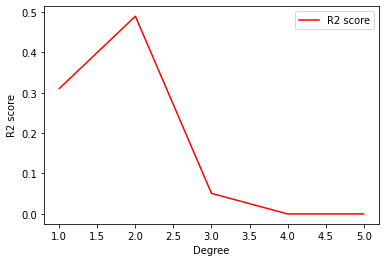

In [ ]:
degree = [1,2,3,4,5]
mse = [mean_squared_error(y_test, y_hat_1),mean_squared_error(y_test, y_hat_5),mean_squared_error(y_test, y_hat_6),mean_squared_error(y_test, y_hat_7),mean_squared_error(y_test, y_hat_8)]
r2 = [r2_score(y_hat_1, y_test),r2_score(y_hat_5, y_test),r2_score(y_hat_6, y_test),r2_score(y_hat_7, y_test),r2_score(y_hat_8, y_test)]
plt.plot(degree, r2, c='r', label='R2 score')
plt.legend()
plt.xlabel("Degree")
plt.ylabel("R2 score")

Text(0, 0.5, 'MSE')

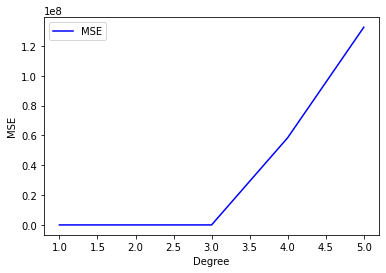

In [ ]:
plt.plot(degree, mse, c='b', label='MSE')
plt.legend()
plt.xlabel("Degree")
plt.ylabel("MSE")

In [ ]:
#Using lesser features
X_train2, X_test2, y_train2, y_test2 = train_test_split(df.iloc[:,1:4], df.iloc[:,8])

In [ ]:
#Using LinearRegression()
reg.fit(X_train2, y_train2)
y_hat_9 = reg.predict(X_test2)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test2, y_hat_9))
print("The R2 score for the model is %.2f" %r2_score(y_hat_9, y_test2))

The mean squared error for the model is 1.10
The R2 score for the model is -4.09


In [ ]:
poly = PolynomialFeatures(degree=2)
X_train_2 = poly.fit_transform(X_train2)
reg.fit(X_train_2, y_train2)
X_test_2 = poly.fit_transform(X_test2)
y_hat_10 = reg.predict(X_test_2)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test2, y_hat_10))
print("The R2 score for the model is %.2f" %r2_score(y_hat_10, y_test2))

The mean squared error for the model is 1.07
The R2 score for the model is -2.43


In [ ]:
poly = PolynomialFeatures(degree=3)
X_train_2 = poly.fit_transform(X_train2)
reg.fit(X_train_2, y_train2)
X_test_2 = poly.fit_transform(X_test2)
y_hat_11 = reg.predict(X_test_2)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test2, y_hat_11))
print("The R2 score for the model is %.2f" %r2_score(y_hat_11, y_test2))

The mean squared error for the model is 2.36
The R2 score for the model is -0.30


In [ ]:
poly = PolynomialFeatures(degree=4)
X_train_2 = poly.fit_transform(X_train2)
reg.fit(X_train_2, y_train2)
X_test_2 = poly.fit_transform(X_test2)
y_hat_12 = reg.predict(X_test_2)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test2, y_hat_12))
print("The R2 score for the model is %.2f" %r2_score(y_hat_12, y_test2))

The mean squared error for the model is 2.40
The R2 score for the model is -0.38


In [ ]:
poly = PolynomialFeatures(degree=5)
X_train_2 = poly.fit_transform(X_train2)
reg.fit(X_train_2, y_train2)
X_test_2 = poly.fit_transform(X_test2)
y_hat_13 = reg.predict(X_test_2)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test2, y_hat_13))
print("The R2 score for the model is %.2f" %r2_score(y_hat_13, y_test2))

The mean squared error for the model is 1381.44
The R2 score for the model is 0.00


In [ ]:
poly = PolynomialFeatures(degree=6)
X_train_2 = poly.fit_transform(X_train2)
reg.fit(X_train_2, y_train2)
X_test_2 = poly.fit_transform(X_test2)
y_hat_14 = reg.predict(X_test_2)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test2, y_hat_14))
print("The R2 score for the model is %.2f" %r2_score(y_hat_14, y_test2))

The mean squared error for the model is 51088.75
The R2 score for the model is 0.00


In [ ]:
poly = PolynomialFeatures(degree=7)
X_train_2 = poly.fit_transform(X_train2)
reg.fit(X_train_2, y_train2)
X_test_2 = poly.fit_transform(X_test2)
y_hat_15 = reg.predict(X_test_2)
print("The mean squared error for the model is %.2f" %mean_squared_error(y_test2, y_hat_15))
print("The R2 score for the model is %.2f" %r2_score(y_hat_15, y_test2))

The mean squared error for the model is 121206452.06
The R2 score for the model is -0.00


Text(0, 0.5, 'R2 score')

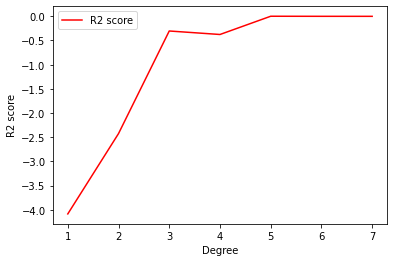

In [ ]:
degree_ = [1,2,3,4,5,6,7]
mse_ = [mean_squared_error(y_test2, y_hat_9),mean_squared_error(y_test2, y_hat_10),mean_squared_error(y_test2, y_hat_11),mean_squared_error(y_test2, y_hat_12),mean_squared_error(y_test2, y_hat_13),mean_squared_error(y_test2, y_hat_14),mean_squared_error(y_test2, y_hat_15)]
r2_ = [r2_score(y_hat_9, y_test2),r2_score(y_hat_10, y_test2),r2_score(y_hat_11, y_test2),r2_score(y_hat_12, y_test2),r2_score(y_hat_13, y_test2),r2_score(y_hat_14, y_test2),r2_score(y_hat_15, y_test2)]
plt.plot(degree_, r2_, c='r', label='R2 score')
plt.legend()
plt.xlabel("Degree")
plt.ylabel("R2 score")

Text(0, 0.5, 'MSE')

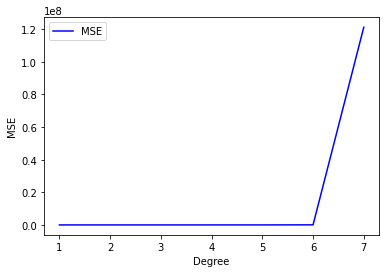

In [ ]:
plt.plot(degree_, mse_, c='b', label='MSE')
plt.legend()
plt.xlabel("Degree")
plt.ylabel("MSE")